### 統計學習初論 (Spring, 2019)
Homework 4
#### 截止日期: 9AM, 2019/4/30
請將HTML檔上傳至Ceiba作業區。回答作業時建議使用 "三明治" 答題法。也就是說，先說明要做什麼，然後列出程式碼與結果，最後說明這些結果的意義。作業自己做。嚴禁抄襲。不接受紙本繳交，不接受遲交。請以英文或中文作答。

#### Data Visualization via Dimensionality Reduction
Data visualization is an useful technique that is often used to understand the characteristics of a dataset. We are going to practice this skill using a university department offer of admission dataset.

#### Dataset: University Department Offer of Admission Dataset (UDOAD; 大學推薦甄選資料集)
A large portion of high school students get admitted to universities through an application and screening process that require each university department of offer admission to applicants first before students can choose where they wants to go. If we think of applicants as the customers of an academic department, then the duplications of offered applicants for different departments can be used to understand the competition relationships between academic departments. We are going to visualize this competition relationships using the University Department Offer of Admission Dataset (UDOAD).

UDOAD was collected through a popular online offer searching service (https://freshman.tw/) for the 2017 academic year. We collected the offers recieved by each applicant as well as the basic information for academic departments. This dataset contains two files

- student_admission106.csv: the offers received by each student applicant.
- univ_name106short1.csv: the basic information, such as the name and field of academic departments.
Below is the first few records of these two files:

In [1]:
import numpy as np
import pandas as pd

stu_adm = pd.read_csv('ds/student_admission106.csv', encoding="utf-8", dtype=str)
uname = pd.read_csv('ds/univ_name106short1.csv', encoding="utf-8", dtype=str)

all_depid = stu_adm['department_id'].unique()
all_stuid = stu_adm['student_id'].unique()

ndepid = all_depid.shape[0]
nstuid = all_stuid.shape[0]
print("There are %d students and %d departments in total." % (nstuid, ndepid))

print("offers received by students:")
stu_adm.head(20)

/miniconda3/lib/python3.7/site-packages/matplotlib/__init__.py:1003: UserWarning: Duplicate key in file "/miniconda3/lib/python3.7/site-packages/matplotlib/mpl-data/matplotlibrc", line #619
  (fname, cnt))


There are 60461 students and 1976 departments in total.
offers received by students:


,school_id,department_id,student_id,student_name,state,location1,location2
0,001,001012,10246842,黃士玹,正1,南部,台南考區
1,001,001012,10042237,黃冠婷,正2,北部,台北考區
2,001,001012,10008031,鍾大方,正3,北部,台北考區
3,001,001012,10201525,曾信豪,正4,中部,彰化考區
4,001,001012,10014615,陳品儒,正5,北部,台北考區
5,001,001012,10294018,侯思筠,正6,東部,宜蘭考區
6,001,001012,10022810,吳悅慈,正7,北部,台北考區
7,001,001012,10236223,陳俞潔,正8,南部,台南考區
8,001,001012,10025909,蕭宇廷,正9,北部,台北考區
9,001,001012,10123708,吳岱軒,正10,北部,中壢考區


The department_id can uniquely identify an academic department. We do not care about the ranking of admission here, and you should just ignore the "state" column. We only care about the "co-application" relations in this dataset. You should use student_id to uniquely identify a student applicant.

In [2]:
print("academic department basic information:")
uname.head(10)


academic department basic information:


,year,school_id,department_id,school_name,department_name,category_id,category_name,school_name_abbr,department_name_abbr
0,106,006,006042,國立政治大學,教育學系,1,教育,政大,教育
1,106,006,006052,國立政治大學,教育學系(公費生),1,教育,政大,教育(公)
2,106,006,006062,國立政治大學,教育學系(原住民公費生),1,教育,政大,教育(原住民)
3,106,006,006022,國立政治大學,歷史學系,2,藝術及人文,政大,歷史
4,106,006,006152,國立政治大學,民族學系,2,藝術及人文,政大,民族學
5,106,006,006032,國立政治大學,哲學系,2,藝術及人文,政大,哲學
6,106,006,006262,國立政治大學,英國語文學系,2,藝術及人文,政大,英國語文
7,106,006,006292,國立政治大學,日本語文學系,2,藝術及人文,政大,日本語文
8,106,006,006272,國立政治大學,阿拉伯語文學系,2,藝術及人文,政大,阿拉伯語文
9,106,006,006302,國立政治大學,韓國語文學系,2,藝術及人文,政大,韓國語文


You can use this dataset to identify the name of a department_id. The school_name and department_name contain the "full name" of a academic department. To facilitate visualization, we also provide "shorter names" in school_name_abbr and department_name_abbr. The category_name is the field of an academic department. This field is very important in our visualization exercise since you should color each data point according to its category_name.

### Question 1 [Data Preparation]
(20%) Our focus is the relationships between department. In order to do this we need to convert the raw data into a "matrix" representation. Each row represent an academic department, and each column represent a student applicant. The value of the cell is 1 if a student applied for admission to the corresponding academic department, and 0 otherwise.

To avoid potential numerical problems, we only include an academic department if it received ten or more applications. Moreover, we only include a student applicant if he or she applied for more than one academic department. You need to make sure that both conditions are satisfied in your processed dataset.

Note that the two conditions should be satisfied "as is" in your final dataset. For example, if a student applied for two departments in the original dataset, and one of the department was removed, then this student should be removed as well because the student only applied for one department in the processed dataset.

Answer the following question:

- Q1.1: Report the number of academic department and student applicants in your dataset.


In [3]:
student_id = pd.get_dummies(stu_adm['student_id']).groupby(stu_adm['department_id']).apply(max)
# a = pd.crosstab(index=stu_adm['department_id'], columns = stu_adm['student_id'])

In [142]:
# group_std = stu_adm.groupby('department_id')
# table = pd.DataFrame()
# count = 0
# for i in all_depid:
#     if count %100 == 0:
#         print(count)
#     count += 1
#     group = group_std.get_group(i)
#     std_dummy = pd.DataFrame(data = np.array([[ 1 for j in range(len(group['student_id']))]]),index = [i], columns = group['student_id'])
#     table = pd.concat([table, std_dummy], sort = False)
#     table = table.replace(np.nan, 0)


In [5]:
def row_clean(data):
    cleaned_data = data[data.sum(axis = 1) >= 10]
    if cleaned_data.shape == data.shape:
        return cleaned_data, False
#     cleaned_data = cleaned_data.reset_index(drop=True)
    return cleaned_data, True

def column_clean(data):
    cleaned_data = data.loc[:, data.sum(axis = 0) > 1]
    if cleaned_data.shape == data.shape:
        return cleaned_data, False
    return cleaned_data, True

revised_table = student_id.copy()

print('Before data cleaning: ','department number: ', revised_table.shape[0], ', student applicant number: ', revised_table.shape[1])
flag_row = True
flag_col = True
check = True
while(check):
    revised_table, flag_row = row_clean(revised_table)
    revised_table, flag_col = column_clean(revised_table)
    if (flag_row or flag_col):
        check = True
    else:
        check = False
print('After data cleaning: ','department number: ', revised_table.shape[0], ', student applicant number: ', revised_table.shape[1])

Before data cleaning:  department number:  1976 , student applicant number:  60461
After data cleaning:  department number:  1917 , student applicant number:  47386


- Q1.2: Report the top ten departments that recieved the most applications and the number of applications they received. Identify the department by their department_id and names.

In [6]:
top_ten = revised_table.sum(axis = 1).sort_values(ascending=False).head(10)
df = pd.DataFrame({'sum':top_ten.values, 'department_id':top_ten.index})
top_ten_info = uname[ uname['department_id'].isin( top_ten.index)]
top_ten_info = top_ten_info.reset_index(drop = True)
res = top_ten_info.loc[:,['department_id', 'school_name','department_name']]
res = pd.merge(res, df, on=['department_id']).sort_values(by = 'sum',ascending=False)
res = res.reset_index(drop = True)
print(res)

  department_id school_name department_name  sum
0        008122        中原大學          機械工程學系  386
1        012052      中國醫藥大學             藥學系  376
2        046032        銘傳大學      會計學系（臺北校區）  367
3        004382      國立成功大學          電機工程學系  357
4        005192        東吳大學          企業管理學系  353
5        008112        中原大學          土木工程學系  353
6        005182        東吳大學            會計學系  351
7        015342        逢甲大學          財務金融學系  340
8        045012        義守大學          電機工程學系  339
9        015222        逢甲大學          資訊工程學系  329


### Question 2 [Explore]
(50%) Visualize academic departments in the following questions. In all plots, you should color data points according the academic department's category. Moreover, you should provide a legend or a picture that illustrate the mapping between colors and category names. Visualize the data using two-dimensional plots. Note that it is your responsible to study the document of libraries of your choice and make sure that the results are reasonable.


### plot figure and settings

In [7]:
def plot(data, cols, x= None, y= None):
    plt.rcParams['font.sans-serif'] = ['SimHei'] 
    plt.rcParams['axes.unicode_minus'] = False
    plt.rcParams['figure.figsize'] = 10, 10
    result = pd.DataFrame(data, index = depart_id, columns= cols)
    result['category_name'] = [0 for j in range(len(result))]
    for i in CATEGORY:
        ### append category name to data
        name =  uname.loc[uname['category_id']== i]['category_name'].unique()[0] 
        result.loc[ result.index.isin(cat_dict[i]) , ['category_name']] = name
    ax = sns.scatterplot(x = x, y= y, data = result, hue = 'category_name')
    plt.show()
    return ax

### append category name to data

In [8]:
CATEGORY = ['1', '2', '3', '4', '5', '6', '7', '9', '99', '8', '10']

cat_dict = dict()
for i in CATEGORY:
    cat_dict[i] = (uname.loc[uname['category_id'] == i])['department_id'].values


### Q2.1: Visualize academic departments using the first 8 principle components. Use your judegement to select multiple pairs of principle components to visualize. Discuss the visual patterns with respect to department categories.


In [110]:
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns; sns.set()
from sklearn.decomposition import PCA

input_data = revised_table.copy()
depart_id = list(input_data.index)
pca = PCA(n_components = 8)
transform = pca.fit_transform(input_data)

### plot all pair of principle components 

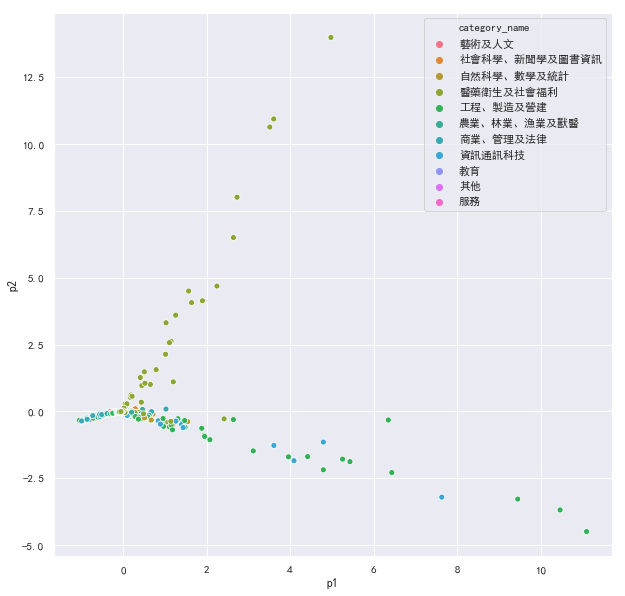

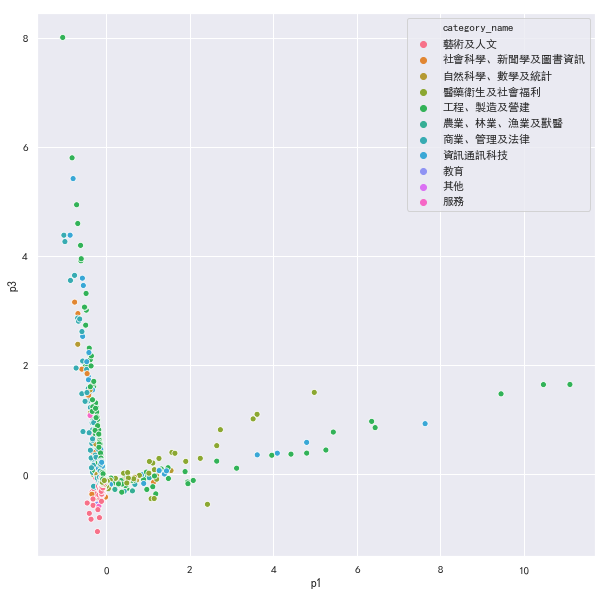

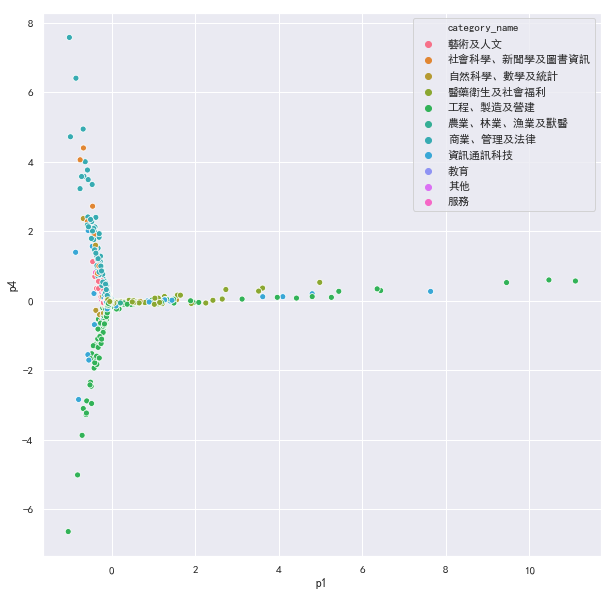

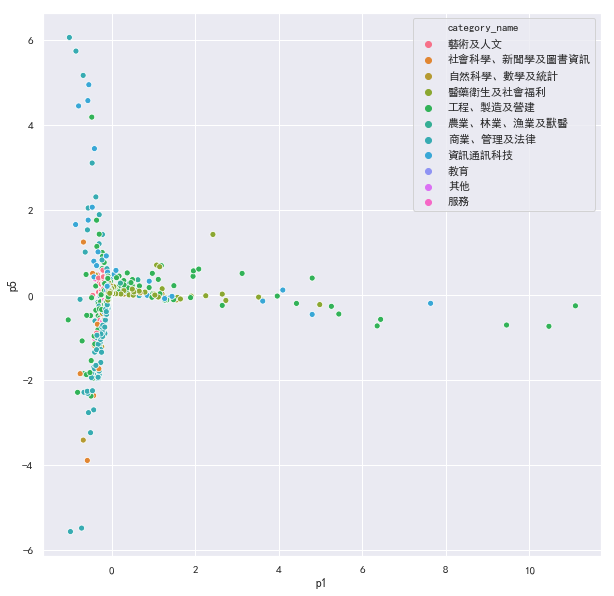

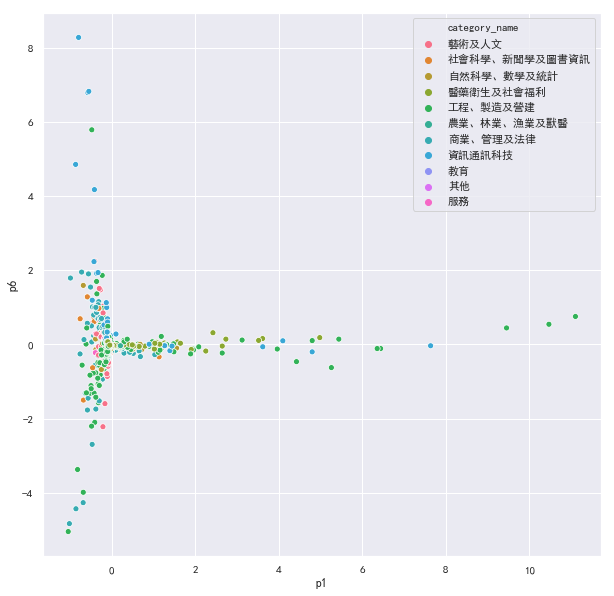

...

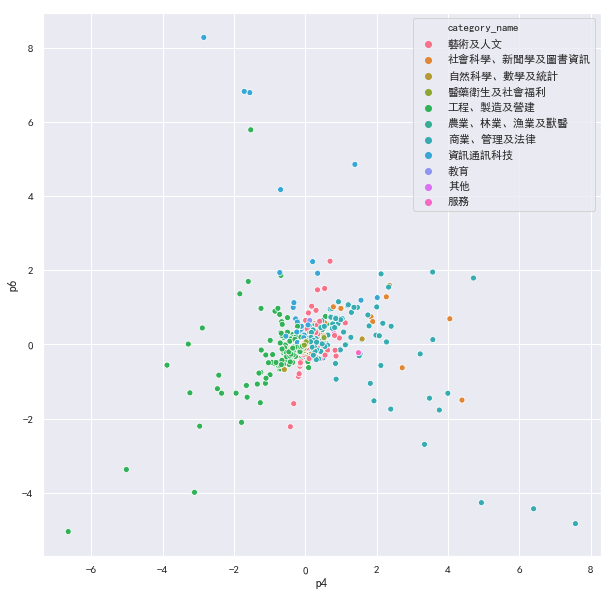

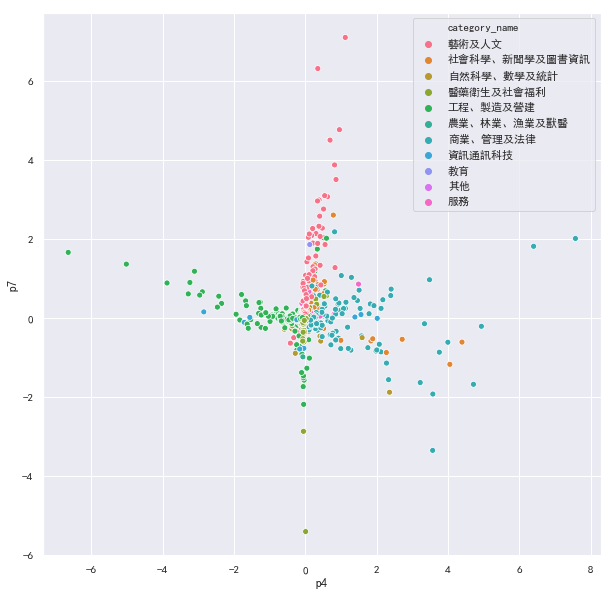

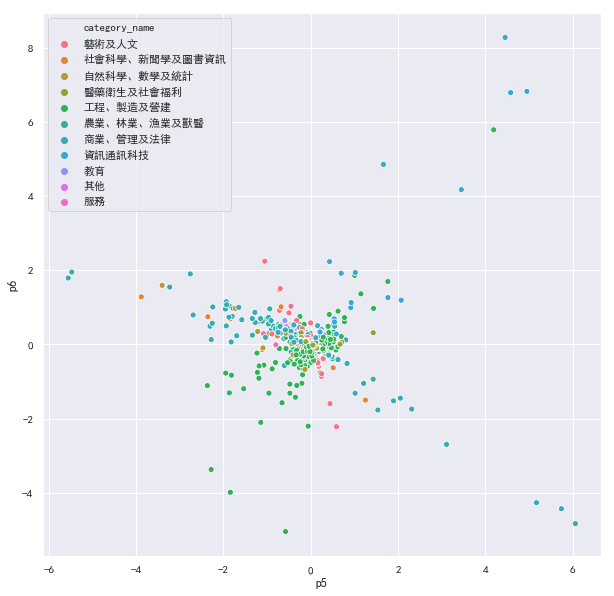

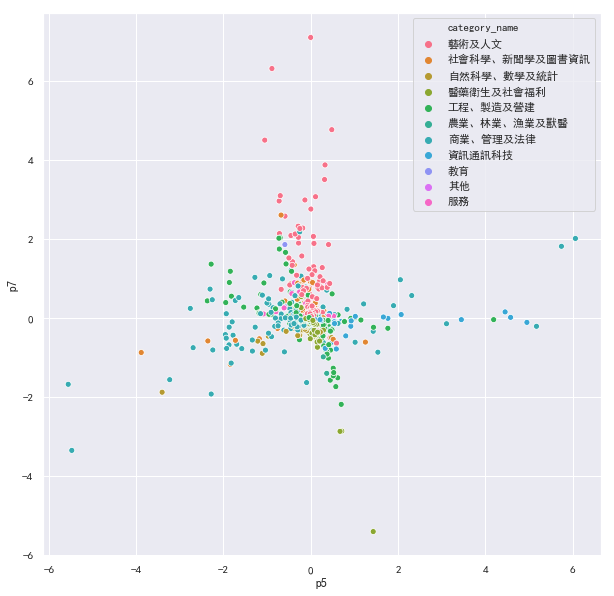

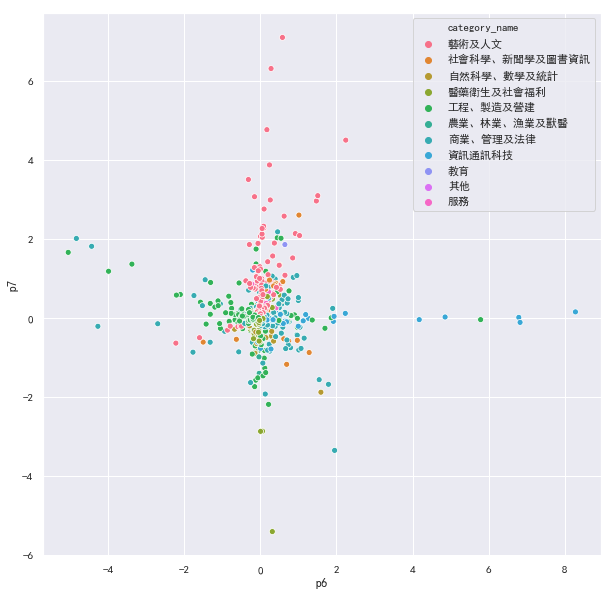

In [113]:
for i in range(1, 7):
    for j in range(i+1, 8):
        plot(transform, ['p1', 'p2', 'p3', 'p4', 'p5', 'p6', 'p7', 'p8'], 'p'+ str(i), 'p'+ str(j))

### select 4th principle compoent and 7th principle compoent  pair with good visualization

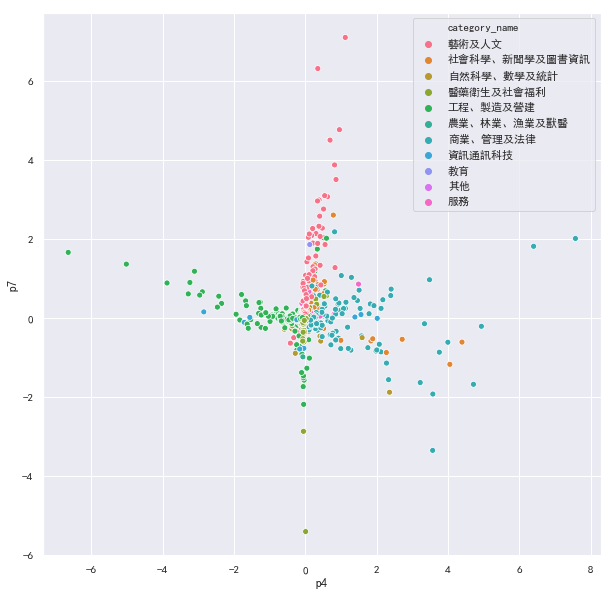

In [116]:
plot(transform, ['p1', 'p2', 'p3', 'p4', 'p5', 'p6', 'p7', 'p8'], 'p4', 'p7')

- 圖中可看見在藝術與人文領域、商業管理及法律領域及工程製造及營建領域的資料點有較明顯的群集，其他領域的資料點則聚集在圓點附近，沒有明顯的分群。

### Q2.2: Visualize academic department using multiple dimensional scaling. Consdier both the metric and non-metric settings. Discuss the result.

### (1) metric MDS

In [84]:
from sklearn.manifold import MDS

input_data = revised_table.copy()
mds = MDS(n_components = 2, metric = True)
transform = mds.fit_transform(input_data)

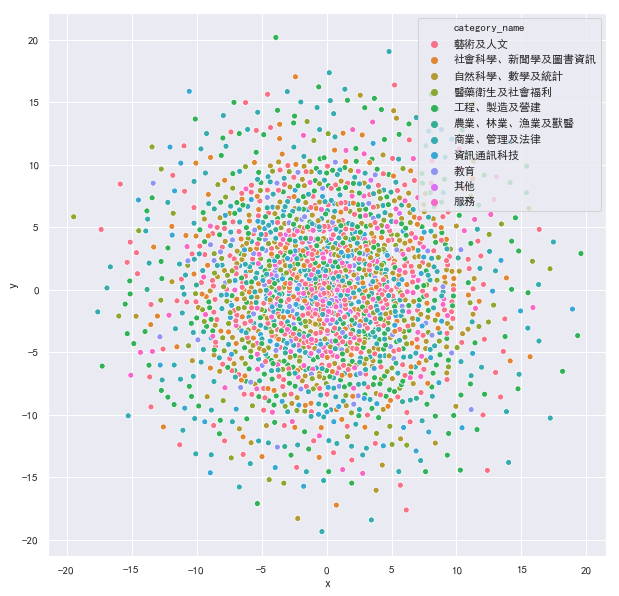

In [85]:
plot(transform, ['x', 'y'], 'x' , 'y')

- 透過 metric MDS 的方式畫出的圖形中，無法清楚的看見明顯的群集，資料點密集的聚集在原點附近，且不同領域的系所無規律的分散在各處。

### (2) non-metric MDS

In [86]:
from sklearn.manifold import MDS

input_data = revised_table.copy()
mds = MDS(n_components = 2, metric = False)
transform = mds.fit_transform(input_data)

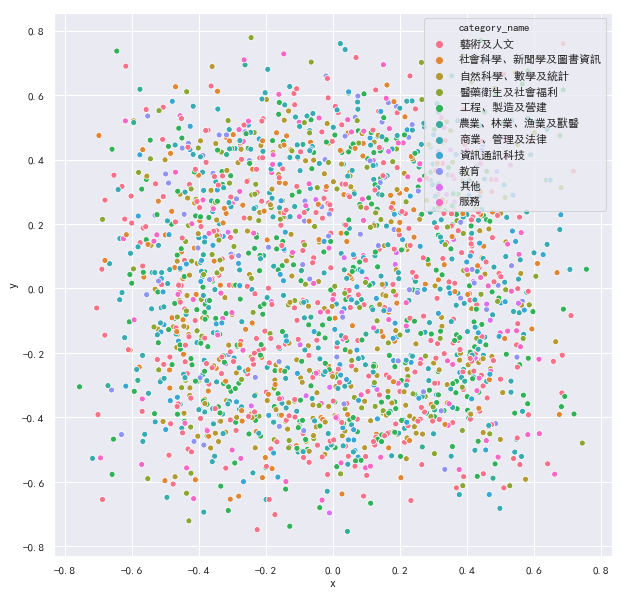

In [87]:
plot(transform, ['x', 'y'], 'x' , 'y')

- 透過 non-metric MDS 的方式畫出的圖形中，無法清楚的看見領顯的群集，資料點相較於 metric 的方式較為分散，但不同領域的系所仍無規律的分散在各處。

### Q2.3: Visualize academic department using Locally Linear Embedding. Consider three variations: (1) Use 20 neighbors to construct the weight matrix; (2) Use 40 neighbors to construct the weight matrix; (3) Perform PCA transformation first, and use the first 100 principle components as the input to LLE (with 20 neighbors). Discuss the result.

### (1) Use 20 neighbors to construct the weight matrix

In [88]:
from sklearn.manifold import LocallyLinearEmbedding

input_data = revised_table.copy()
lle = LocallyLinearEmbedding(n_components=2, n_neighbors = 20)
transform = lle.fit_transform(input_data)


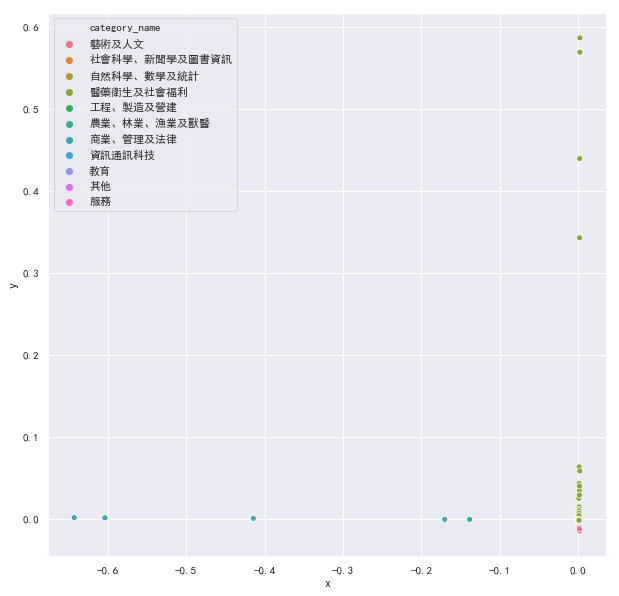

In [89]:
plot(transform, ['x', 'y'], 'x' , 'y')

- 用 LLE (with 20 neighbors) 的方式沒有明顯的分群，且資料點重疊出現在原點附近。

### (2) Use 40 neighbors to construct the weight matrix

In [90]:
from sklearn.manifold import LocallyLinearEmbedding

input_data = revised_table.copy()
lle = LocallyLinearEmbedding(n_components=2, n_neighbors = 40)
transform = lle.fit_transform(input_data)

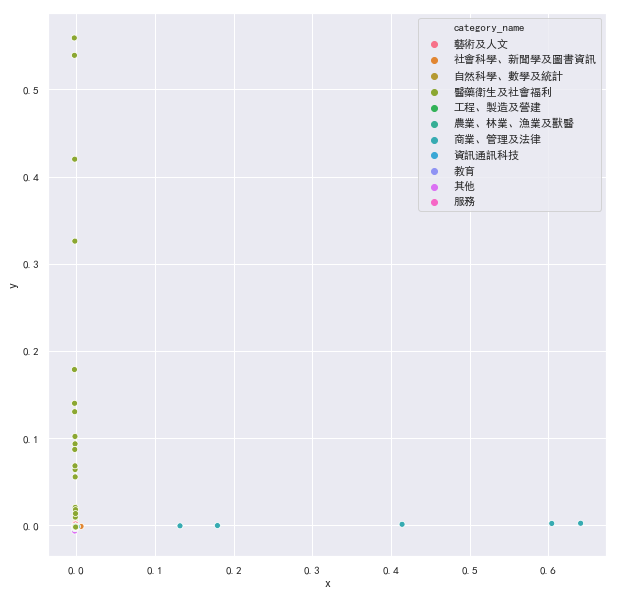

In [91]:
plot(transform, ['x', 'y'], 'x' , 'y')

- 用 LLE (with 40 neighbors) 的方式沒有明顯的分群，且資料點重疊出現在原點附近。

### (3) Perform PCA transformation first, and use the first 100 principle components as the input to LLE (with 20 neighbors). Discuss the result.

In [92]:
pca = PCA(n_components = 100)
input_data = revised_table.copy()
transform = pca.fit_transform(input_data)
lle = LocallyLinearEmbedding(n_components=2, n_neighbors = 20)
transform_final = lle.fit_transform(transform)

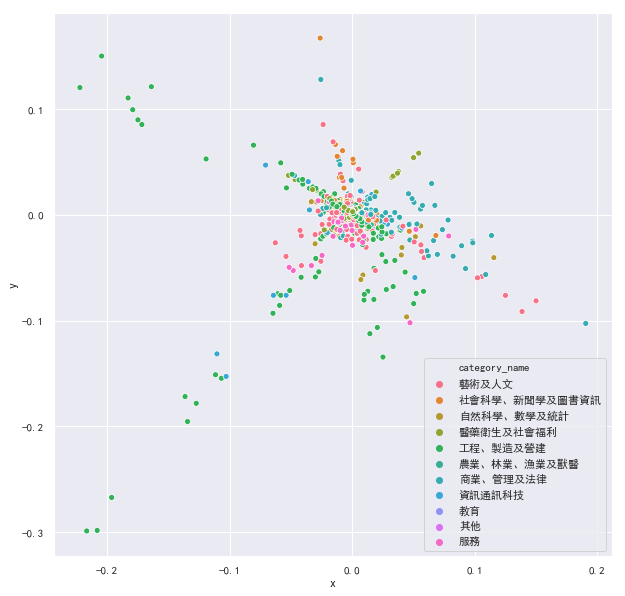

In [94]:
plot(transform_final, ['x', 'y'], 'x' , 'y')

- 先利用 PCA 處理過後再使用 LLE (with 20 neighbors) 的結果比前兩者好，有較明顯的分群，但資料點仍較為重疊。

### Q2.4: Visualize academic department using Kernel PCA. You should at least consider the RBF and Cosine kernel. It is your responsibility to select reasonably good kernel parameters. Discuss the result.

### (1) RBF Kernel

In [128]:
from sklearn.decomposition import KernelPCA

input_data = revised_table.copy()
kernel_pca = KernelPCA(n_components = 8, kernel='rbf')
transform = kernel_pca.fit_transform(input_data)

### plot all pairs of principle components 

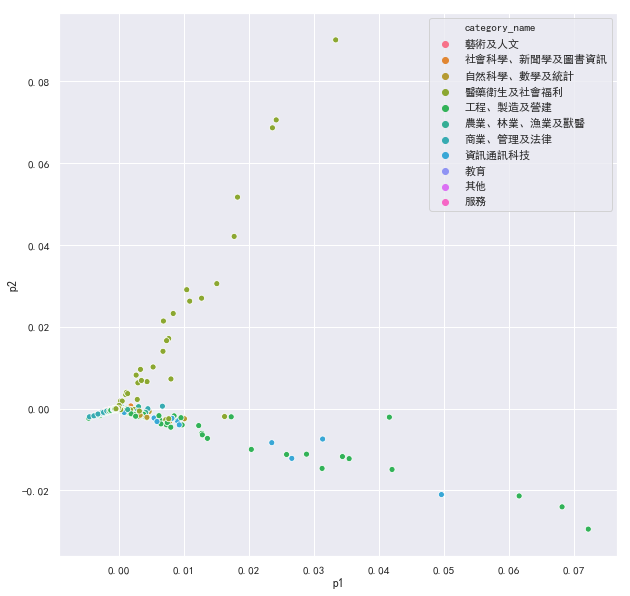

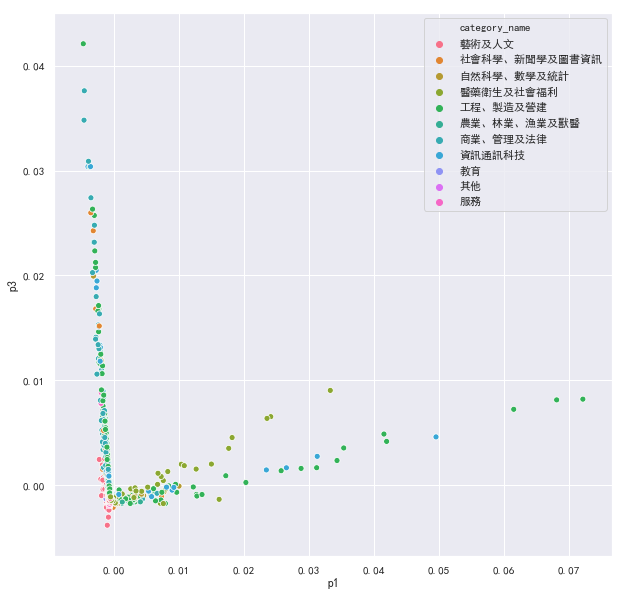

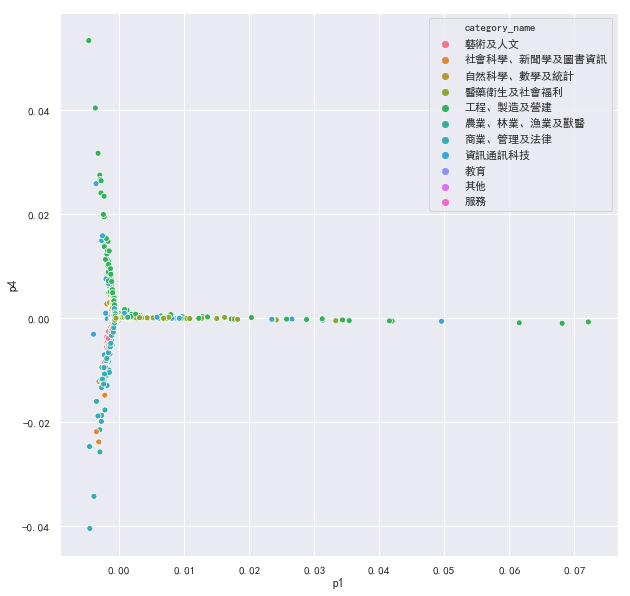

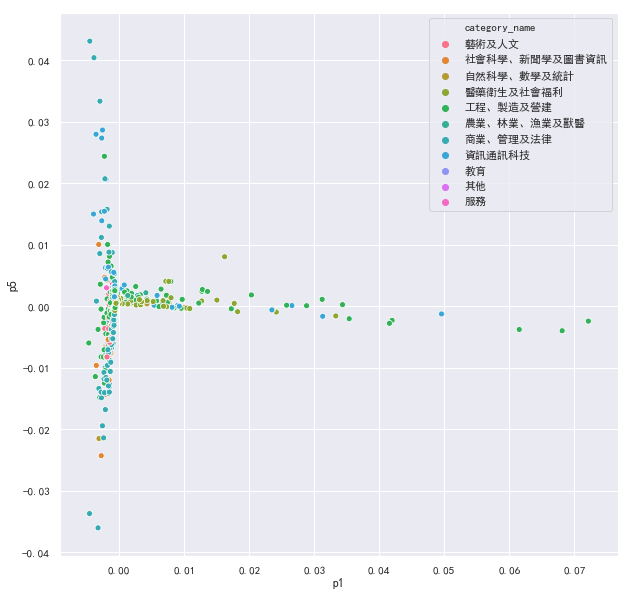

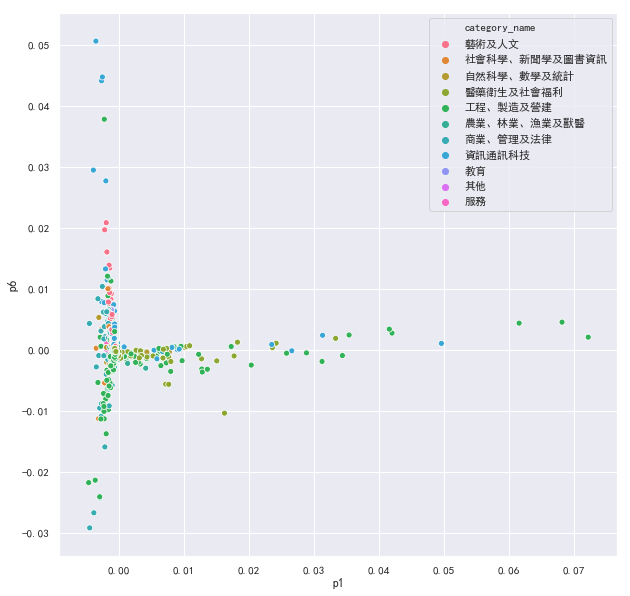

...

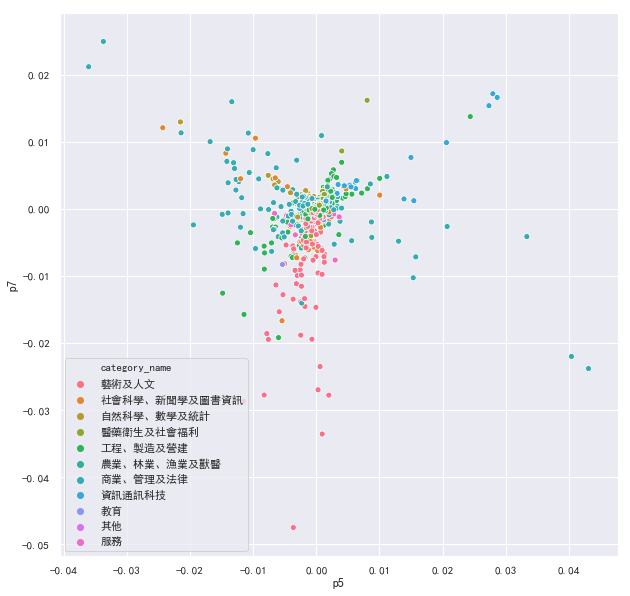

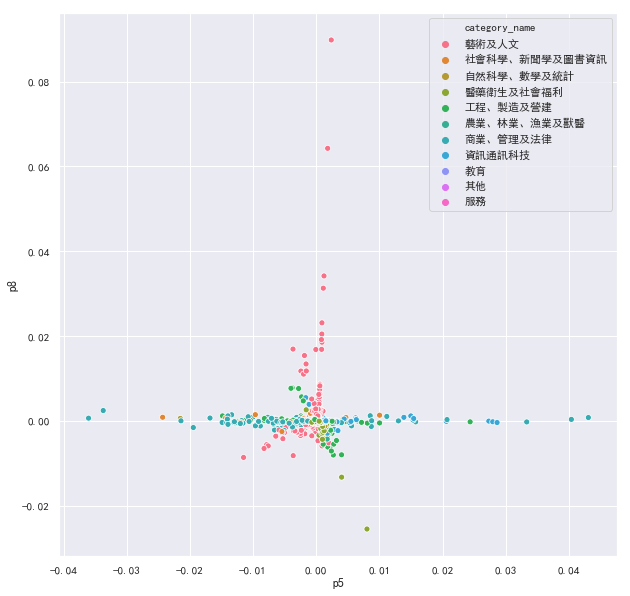

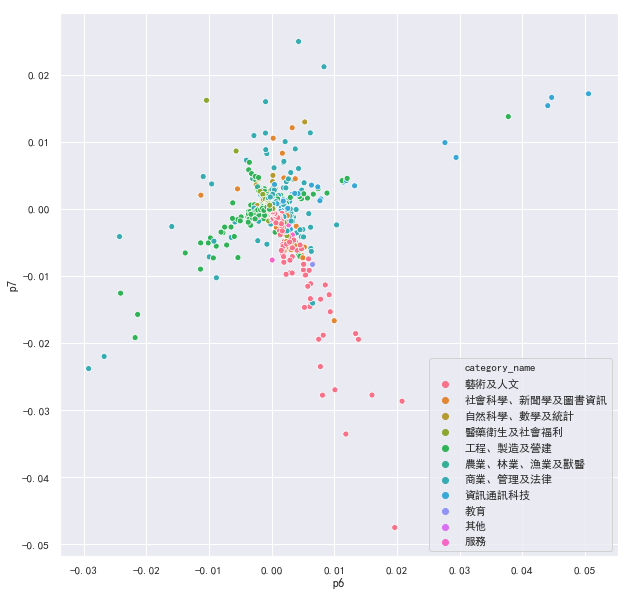

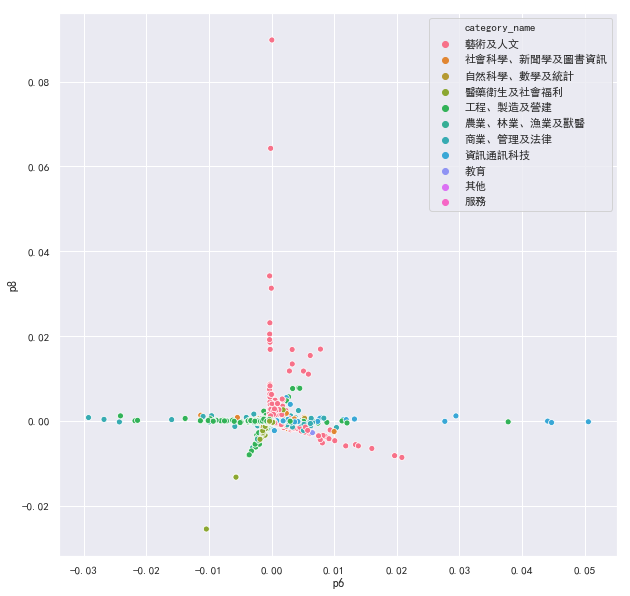

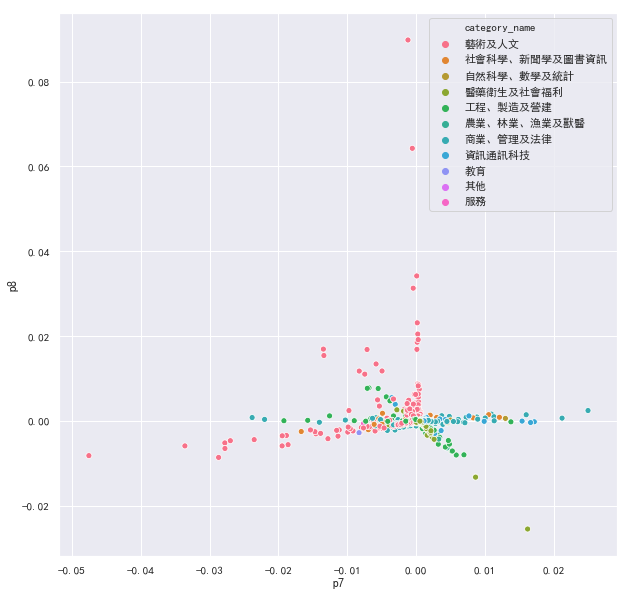

In [131]:
for i in range(1, 8):
    for j in range(i+1, 9):
        plot(transform, ['p1','p2', 'p3', 'p4', 'p5', 'p6', 'p7', 'p8'], 'p'+ str(i) , 'p' + str(j))
        

### select 4th principle compoent and 7th principle compoent  pair with good visualization

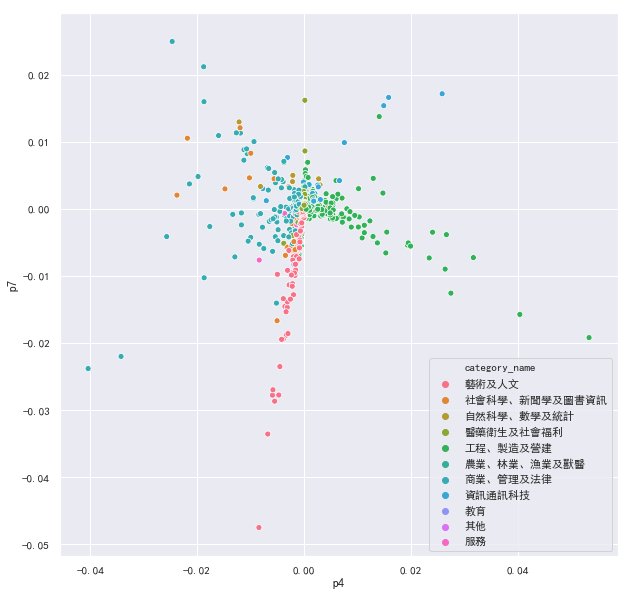

In [132]:
plot(transform, ['p1','p2', 'p3', 'p4', 'p5', 'p6', 'p7', 'p8'], 'p4', 'p7')

- 圖中可看見在藝術與人文領域、商業管理及法律領域、工程製造及營建領域和社會科學、新文學及圖書資訊領域的資料點有較明顯的群集，其他領域的資料點則聚集在圓點附近，沒有明顯的分群。

### (2) Cosine Kernel

In [133]:
from sklearn.decomposition import KernelPCA

input_data = revised_table.copy()
kernel_pca = KernelPCA(n_components = 8, kernel='cosine')
transform = kernel_pca.fit_transform(input_data)

### plot all pairs of principle components 

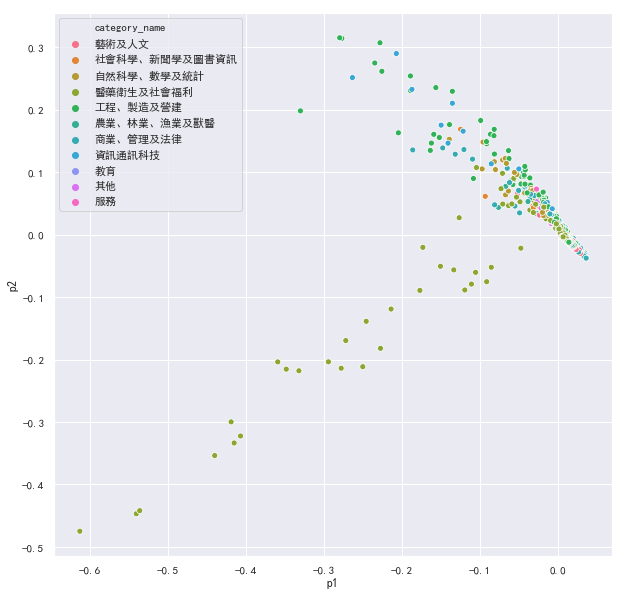

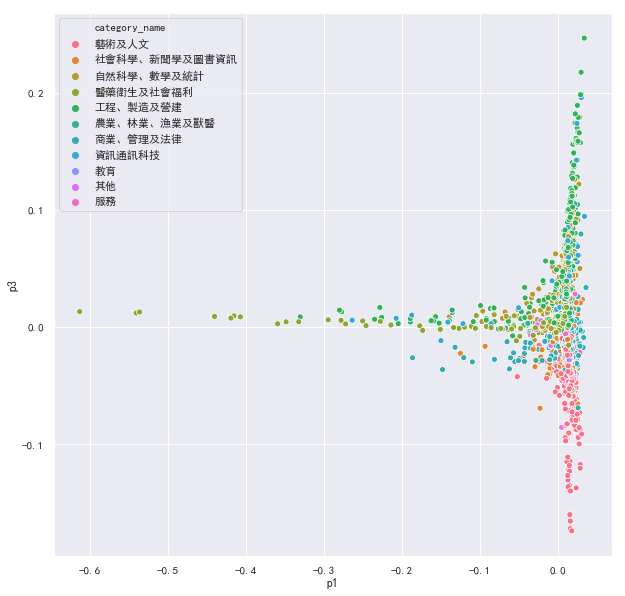

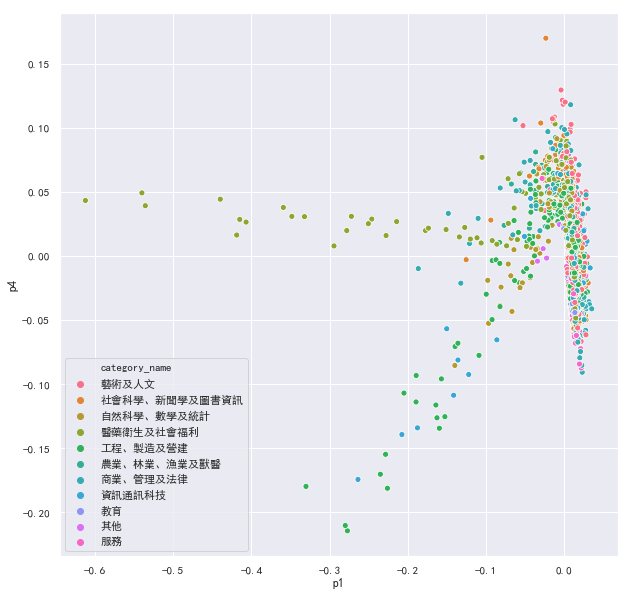

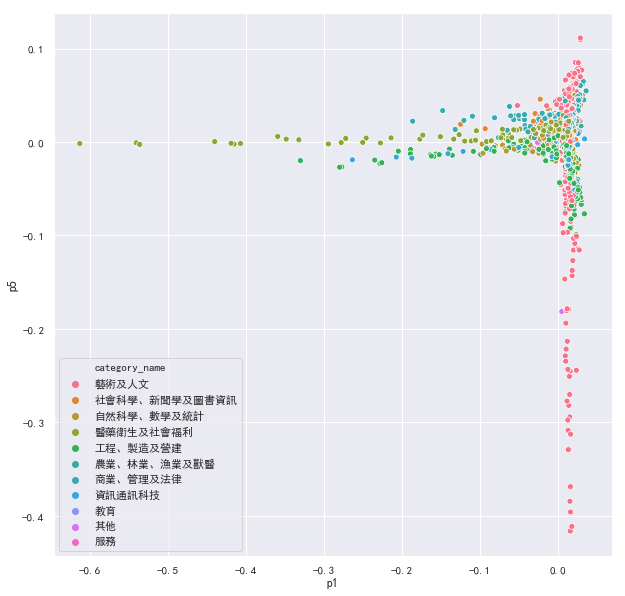

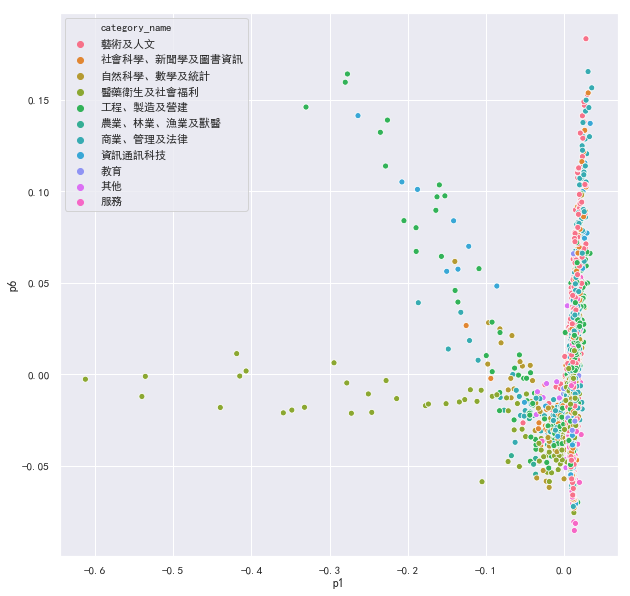

...

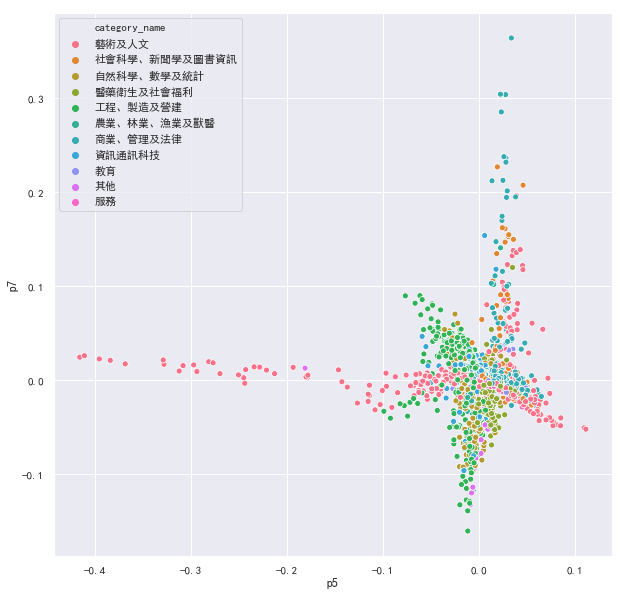

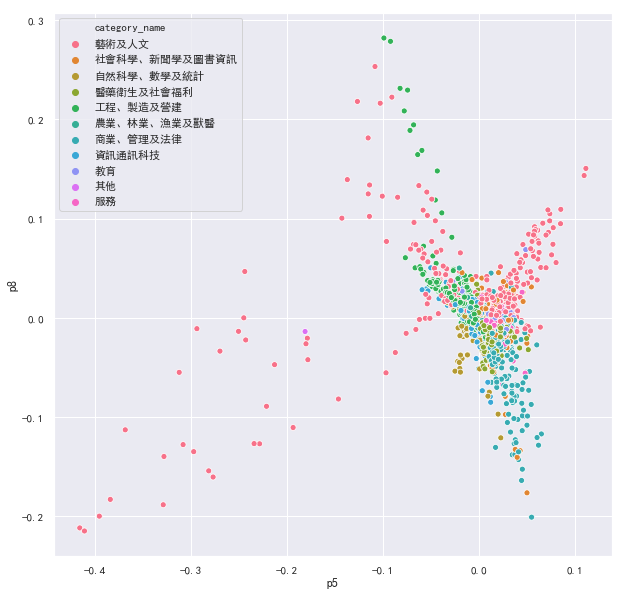

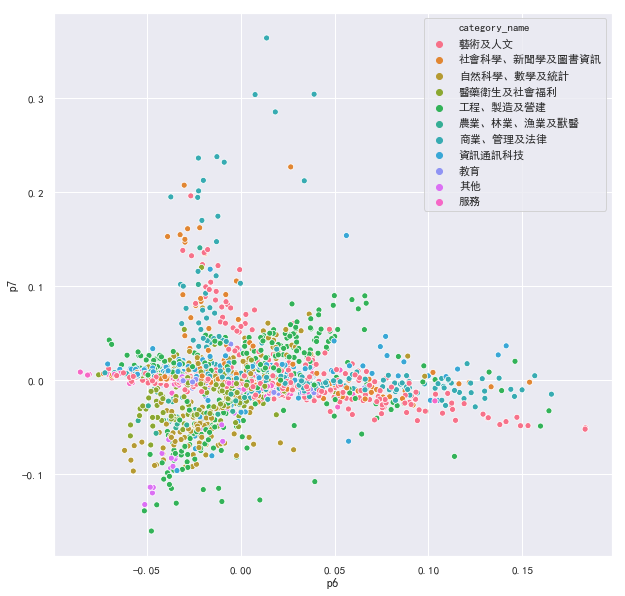

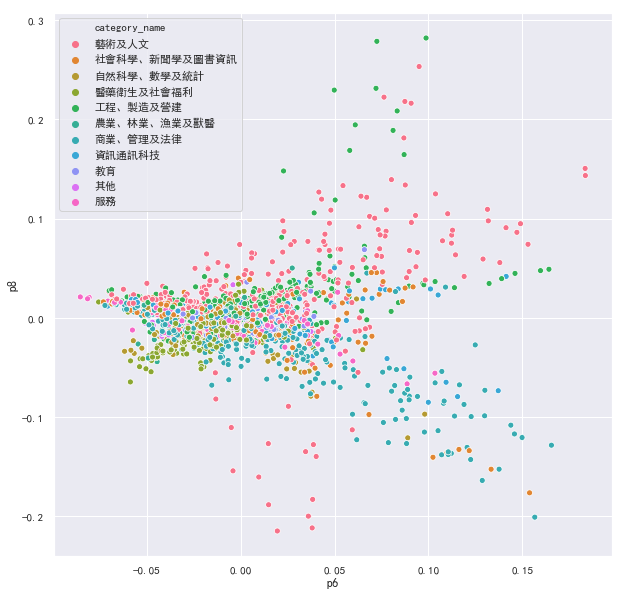

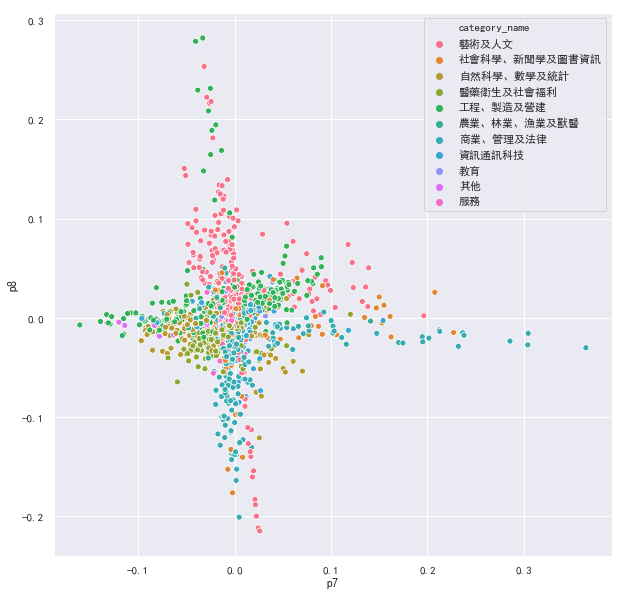

In [135]:
for i in range(1, 8):
    for j in range(i+1, 9):
        plot(transform, ['p1','p2', 'p3', 'p4', 'p5', 'p6','p7', 'p8'], 'p'+ str(i) , 'p' + str(j))

### select 3th principle compoent and 4th principle compoent  pair with good visualization

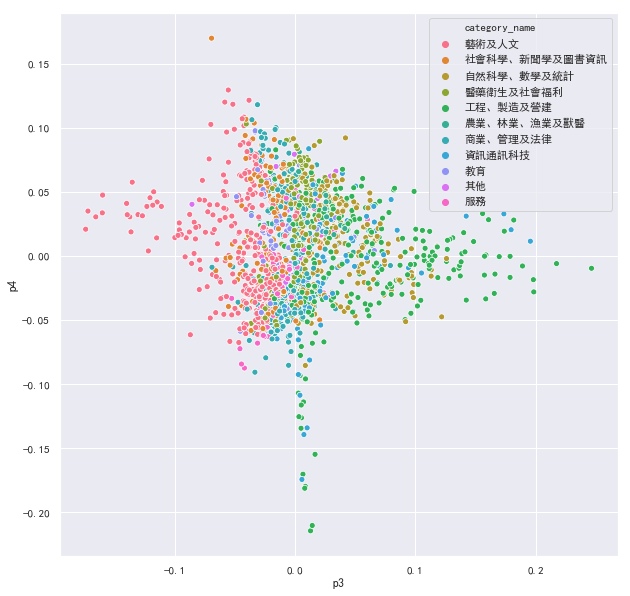

In [143]:
plot(transform, ['p1','p2', 'p3', 'p4', 'p5', 'p6','p7', 'p8'], 'p3', 'p4' )

- 圖中可雖然資料點仍較為集中，但可看見各領域的群集內的資料點明顯的靠近，各領域形成自己的群集。

### Q2.5: Visualize academic department using t-SNE. You should consider at least the Euclidian, Cosine, and Jaccard metric. Set numpy random seed so that your results can be repeated. Discuss the result.

### (1)  Euclidian

In [103]:
from sklearn.manifold import TSNE

input_data = revised_table.copy()
transform = TSNE(n_components=2).fit_transform(input_data)

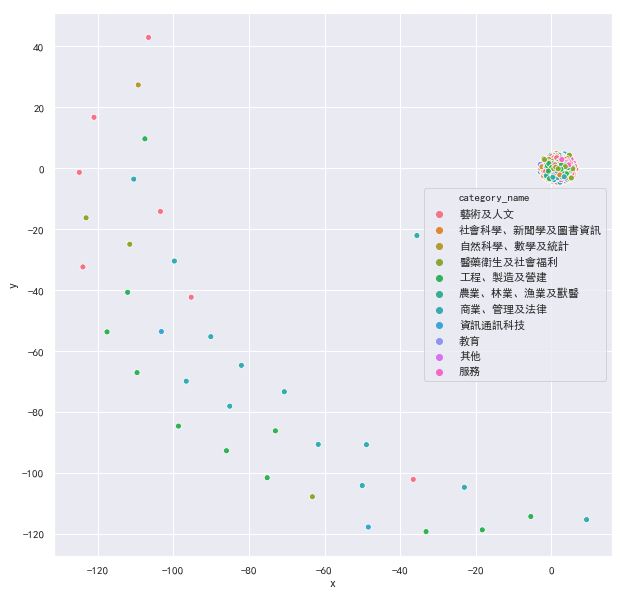

In [104]:
plot(transform, ['x','y'],'x','y')

- 利用 Euclidian 方式使的資料多重疊在原點附近。

### (2) Cosine

In [181]:
from sklearn.manifold import TSNE

input_data = revised_table.copy()
transform = TSNE(n_components=2,metric = 'cosine').fit_transform(input_data)

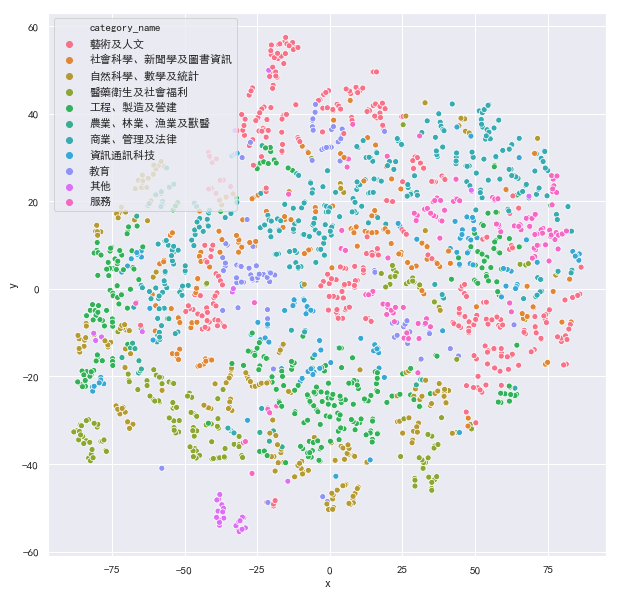

In [171]:
final_plot = plot(transform, ['x','y'], 'x', 'y')

- 利用 cosine 的計算方式畫出上圖，從圖中可以明顯看見各個領域形成各自的群集，且不同領域的資料點多不重疊，讓人可以清楚看見個領域的組別。

### (3) Jaccard 

In [107]:
from sklearn.manifold import TSNE

input_data = revised_table.copy()
transform = TSNE(n_components=2, metric='jaccard').fit_transform(input_data)

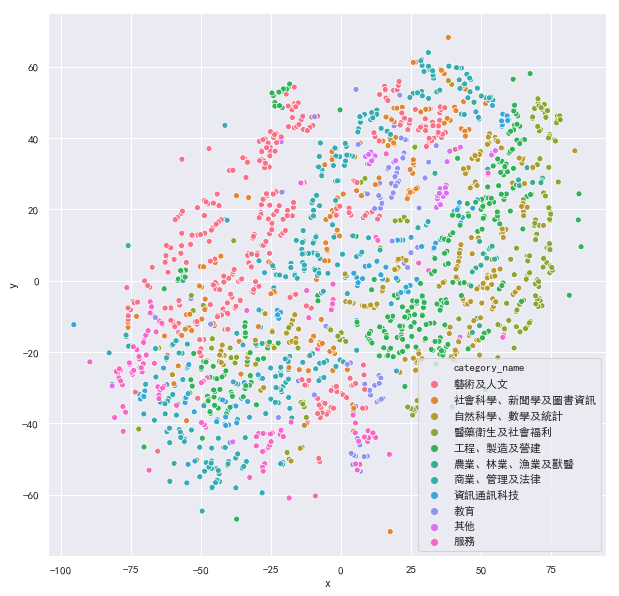

In [108]:
plot(transform, ['x','y'], 'x', 'y')

- 利用jaccard 的計算方式畫出上圖，從圖中可以明顯看見各個領域形成各自的群集，且不同領域的資料點多不重疊，羽 cosine 計算方式產生的圖形比較起來相對密集。

## Question 3 [Refine]
(30%) Select the most promising visualization method in the previous question and refine the result. Your should color points by department category. Label each data point with its name so that we can easily identify a data point on the picture. Moreover, you should try to reduce the problem caused by overlapping points and labels. Output a picture that is large enough so that a user can easily identify a department and its neighbors. Jupyter Notebook has limitations on the largest picture size. To overcome this problem, consider output the picture to a separate file and submit the file for grading. Your score depends on how useful, readable, and visually pleasing of your visualization results.

## select t-SNE with cosine metric method after using pca decomposition

In [60]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

import seaborn as sns; sns.set()
from sklearn.decomposition import PCA,  KernelPCA

input_data = revised_table.copy()
depart_id = list(input_data.index)
pca = PCA(n_components = 100)
transform = pca.fit_transform(input_data)
transform_final = TSNE(n_components = 2,metric = 'cosine').fit_transform(transform)

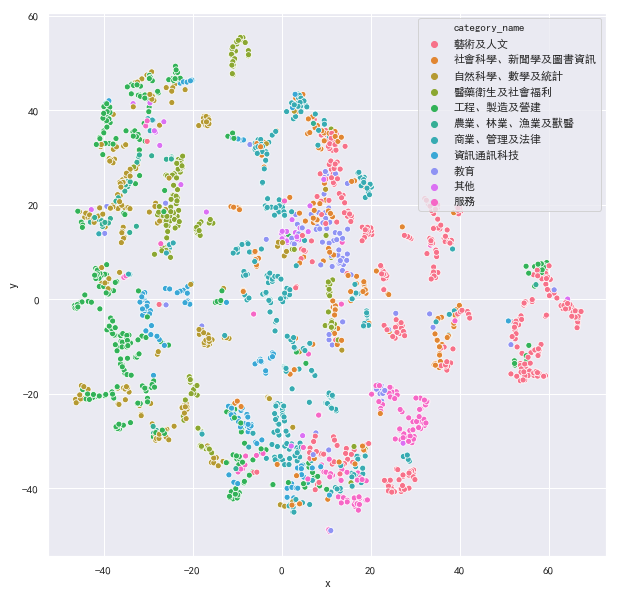

In [61]:
plot(transform_final, ['x','y'], 'x', 'y')

In [64]:
plt.rcParams['font.sans-serif'] = ['SimHei'] 
plt.rcParams['axes.unicode_minus'] = False
plt.rcParams['figure.figsize'] = 150, 150

fig = plt.figure()
result = pd.DataFrame(transform_final, index = depart_id, columns= ['x', 'y'])
result['category_name'] = [0 for j in range(len(result))]
result['department_name'] = ['' for j in range(len(result))]
for i in CATEGORY:
    ### append category name to data
    name =  uname.loc[uname['category_id']== i]['category_name'].unique()[0] 
    result.loc[ result.index.isin(cat_dict[i]) , ['category_name']] = name
    
for i in result.index:
    data =  uname.loc[uname['department_id']== i]
    name = data['school_name'].values[0]+ data['department_name'].values[0]
    result.loc[result.index == i,'name'] = name
size = [1000  for j in range(len(result))]
ax = sns.scatterplot(x = 'x', y= 'y', data = result, hue = 'category_name', s =size)
for i in range(len(result)):
    ax.annotate(result.iloc[i,:]['name'],(result.iloc[i,:]['x'],result.iloc[i,:]['y']))
plt.show()
fig.savefig('q3.png')   # save the figure to file